In [1]:
import pandas as pd
import numpy as np
import random
import gmplot
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from folium import plugins
import random
from sklearn.cluster import KMeans
from sklearn import metrics
from scipy.spatial.distance import cdist
import numpy as np
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import haversine as hs

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
data = pd.read_csv('Gowalla_totalCheckins.txt',delimiter="\t",names=["user", "check-in time", "latitude", "longitude", "location id"])

In [3]:
data.shape

(6442892, 5)

In [4]:
data["date_of_year"] = pd.to_datetime(data["check-in time"]).dt.date

In [5]:
data["time_of_day"] = pd.to_datetime(data["check-in time"]).dt.strftime('%H:%M')

In [6]:
data.dtypes

user               int64
check-in time     object
latitude         float64
longitude        float64
location id        int64
date_of_year      object
time_of_day       object
dtype: object

In [7]:
data.head()

,user,check-in time,latitude,longitude,location id,date_of_year,time_of_day
0,0,2010-10-19T23:55:27Z,30.235909,-97.795140,22847,2010-10-19,23:55
1,0,2010-10-18T22:17:43Z,30.269103,-97.749395,420315,2010-10-18,22:17
2,0,2010-10-17T23:42:03Z,30.255731,-97.763386,316637,2010-10-17,23:42
3,0,2010-10-17T19:26:05Z,30.263418,-97.757597,16516,2010-10-17,19:26
4,0,2010-10-16T18:50:42Z,30.274292,-97.740523,5535878,2010-10-16,18:50


In [8]:
data.shape

(6442892, 7)

In [9]:
data["user"].nunique()

107092

In [10]:
data["location id"].nunique()

1280969

In [11]:
data[data["user"]==0]

,user,check-in time,latitude,longitude,location id,date_of_year,time_of_day
0,0,2010-10-19T23:55:27Z,30.235909,-97.795140,22847,2010-10-19,23:55
1,0,2010-10-18T22:17:43Z,30.269103,-97.749395,420315,2010-10-18,22:17
2,0,2010-10-17T23:42:03Z,30.255731,-97.763386,316637,2010-10-17,23:42
3,0,2010-10-17T19:26:05Z,30.263418,-97.757597,16516,2010-10-17,19:26
4,0,2010-10-16T18:50:42Z,30.274292,-97.740523,5535878,2010-10-16,18:50
...,...,...,...,...,...,...,...
220,0,2010-05-23T17:51:57Z,39.093258,-94.593871,1161876,2010-05-23,17:51
221,0,2010-05-23T16:50:50Z,39.093533,-94.593174,17269,2010-05-23,16:50
222,0,2010-05-22T19:13:12Z,38.985246,-94.605919,18574,2010-05-22,19:13
223,0,2010-05-22T17:50:55Z,39.297443,-94.716053,8977,2010-05-22,17:50


In [12]:
data[data["user"]==0]["date_of_year"].nunique()

113

In [13]:
data[data["user"]==0]["date_of_year"].max()

datetime.date(2010, 10, 19)

In [14]:
data[data["user"]==0]["date_of_year"].min()

datetime.date(2010, 5, 22)

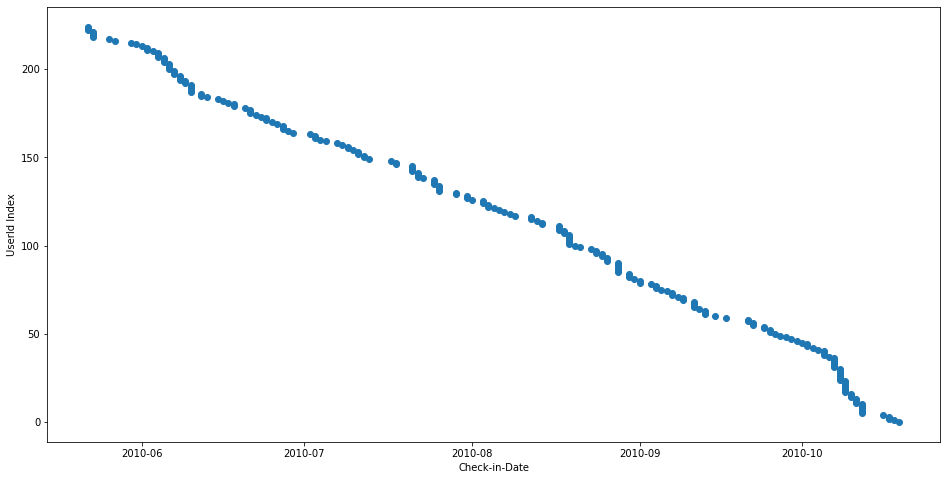

In [15]:
plt.figure(figsize=(16,8))
plt.ylabel("UserId Index")
plt.xlabel("Check-in-Date")
plt.plot_date(data[data["user"]==0]["date_of_year"],data[data["user"]==0].index)

<AxesSubplot:xlabel='date_of_year', ylabel='Count'>

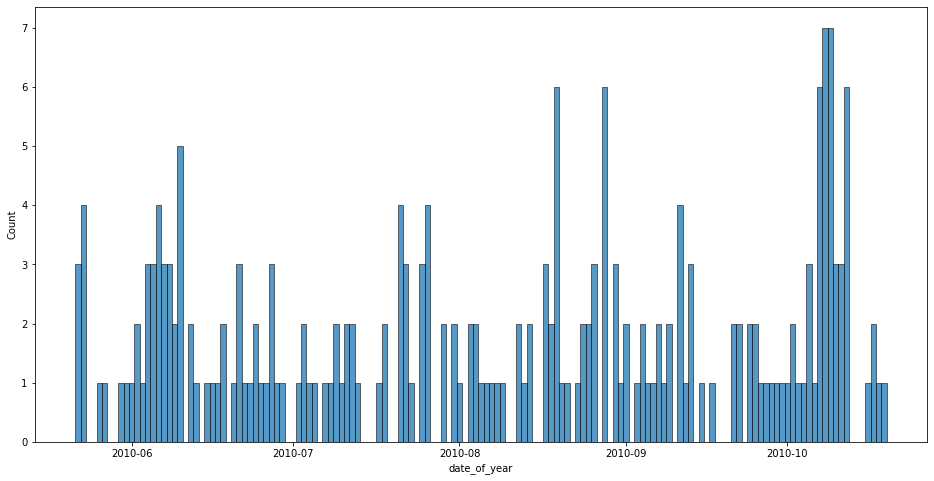

In [16]:
plt.figure(figsize=(16,8))
sns.histplot(data[data["user"]==0]["date_of_year"])

<AxesSubplot:xlabel='time_of_day', ylabel='Count'>

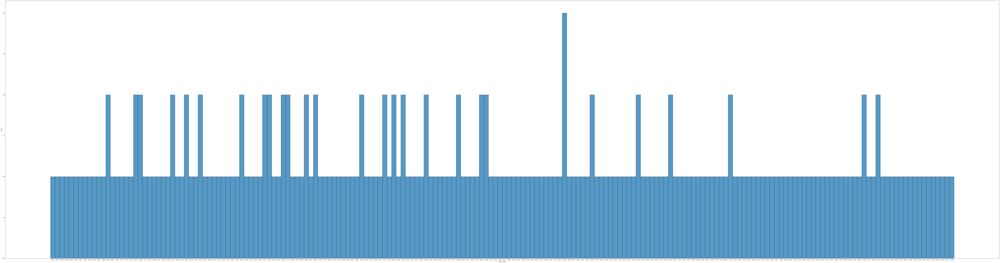

In [17]:
plt.figure(figsize=(150,40))
sns.histplot(data[data["user"]==0]["time_of_day"])

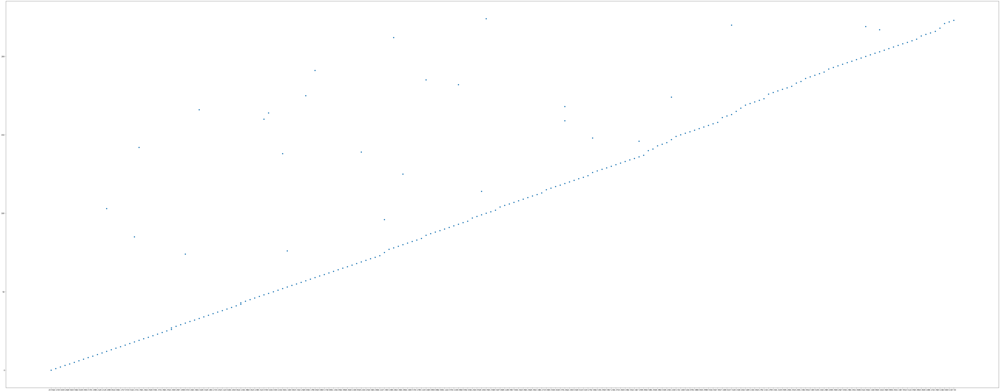

In [18]:
plt.figure(figsize=(100,40))
plt.plot_date(data[data["user"]==0]["time_of_day"],data[data["user"]==0].index)

In [19]:
user_0 = data[data["user"]==0]

In [20]:
data[data["user"]==0].sample()

,user,check-in time,latitude,longitude,location id,date_of_year,time_of_day
196,0,2010-06-08T02:29:37Z,37.785436,-122.403949,19199,2010-06-08,02:29


In [21]:
data[data["user"]==0]["latitude"].values[0]

30.2359091167

In [22]:
data[data["user"]==0].shape[0]

225

In [23]:
# def get_dataframe_dict(dataframe):
#     empty_dict = {}
#     empty_dict["user"] = []
#     empty_dict["longitude"] = []
#     empty_dict["latitude"] = []
#     for i in range(dataframe["user"].nunique()):
#         empty_dict["user"].append(i)
#         mean_longitude = dataframe[dataframe["user"]==i]["longitude"].mean()
#         mean_latitude = dataframe[dataframe["user"]==i]["latitude"].mean()
#         median_latitude = dataframe[dataframe["user"]==i]["latitude"].median()
#         median_longitude = dataframe[dataframe["user"]==i]["longitude"].median()
#         if mean_longitude > median_longitude:
#             empty_dict["longitude"].append(median_longitude)
#         else:
#             empty_dict["longitude"].append(mean_longitude)

#         if mean_latitude > median_longitude:
#             empty_dict["latitude"].append(median_latitude)
#         else: 
#             empty_dict["latitude"].append(mean_latitude)
#     return empty_dict

In [24]:
def get_dataframe_dict(dataframe):
    empty_dict = {}
    empty_dict["user"] = []
    empty_dict["longitude"] = []
    empty_dict["latitude"] = []
    empty_dict["location_id"] = []
    user_id_list = dataframe["user"].unique().tolist()
    for i in user_id_list:
        if dataframe[dataframe["user"]==i].shape[0]!=0:
            data = dataframe[dataframe["user"]==i].sample()
            empty_dict["user"].append(i)
            empty_dict["longitude"].append(data["longitude"].values[0])
            empty_dict["latitude"].append(data["latitude"].values[0])
            empty_dict["location_id"].append(data["location id"].values[0])
        else:
            data = dataframe[dataframe["user"]==i]
            empty_dict["user"].append(i)
            empty_dict["longitude"].append(0)
            empty_dict["latitude"].append(0)
            empty_dict["location_id"].append(0)
    return empty_dict

### Taking New York datapoints only to apply differential privacy

In [25]:
def get_dataframe_dict_nyc(dataframe):
    empty_dict = {}
    empty_dict["user"] = []
    empty_dict["longitude"] = []
    empty_dict["latitude"] = []
    empty_dict["location_id"] = []
    user_id_list = dataframe["user"].unique().tolist()
    for i in user_id_list:
        data = dataframe[dataframe["user"]==i].sample()
        empty_dict["user"].append(i)
        empty_dict["longitude"].append(data["longitude"].values[0])
        empty_dict["latitude"].append(data["latitude"].values[0])
        empty_dict["location_id"].append(data["location id"].values[0])
    return empty_dict

In [26]:
lon_min, lat_min, lon_max, lat_max = -74.2589, 40.4774, -73.7004, 40.9176
nyc_events = data[(data['longitude']>lon_min) & 
           (data['longitude']<lon_max) & 
           (data['latitude']>lat_min) & 
           (data['latitude']<lat_max)]
nyc_events.head()

,user,check-in time,latitude,longitude,location id,date_of_year,time_of_day
10,0,2010-10-12T00:21:28Z,40.643885,-73.782806,23261,2010-10-12,00:21
11,0,2010-10-11T20:21:20Z,40.741374,-73.988105,16907,2010-10-11,20:21
12,0,2010-10-11T20:20:42Z,40.741388,-73.989455,12973,2010-10-11,20:20
13,0,2010-10-11T00:06:30Z,40.724910,-73.994621,341255,2010-10-11,00:06
14,0,2010-10-10T22:00:37Z,40.729768,-73.998535,260957,2010-10-10,22:00


In [27]:
nyc_events.shape

(138957, 7)

In [28]:
nyc_events_dict = get_dataframe_dict_nyc(nyc_events)

In [29]:
nyc_events_single = pd.DataFrame(nyc_events_dict)

In [30]:
m= folium.Map(location=[nyc_events_single["latitude"][0], nyc_events_single["longitude"][0]])
folium.Marker(
    location=[nyc_events_single["latitude"][0], nyc_events_single["longitude"][0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Actual Location', # pop-up label for the marker
    icon=folium.Icon()
).add_to(m)

In [31]:
m

#### Importing Libraries from diffprivlib

In [32]:
from diffprivlib.mechanisms import Gaussian, Uniform

### Applying Gaussian Mechanism

In [33]:
gaussian = Gaussian(epsilon=0.6, delta=0.6, sensitivity=0.001)

In [34]:
nyc_events_single.shape

(7115, 4)

In [35]:
nyc_events_single["latitude"][0:5]

0    40.643885
1    40.756835
2    40.741374
3    40.750614
4    40.721214
Name: latitude, dtype: float64

In [36]:
latitude_gaussian_values = []
for i in range(nyc_events_single["latitude"].shape[0]):
    latitude_gaussian_values.append(gaussian.randomise(nyc_events_single["latitude"].values[i]))

In [37]:
latitude_gaussian_values[0:5]

[40.64650197774486,
 40.76082744608525,
 40.742679108630114,
 40.75291299462045,
 40.71905816482924]

In [38]:
nyc_events_single["longitude"][0:5]

0   -73.782806
1   -73.985056
2   -73.988105
3   -73.993435
4   -73.940631
Name: longitude, dtype: float64

In [39]:
longitude_gaussian_values = []
for i in range(nyc_events_single["longitude"].shape[0]):
    longitude_gaussian_values.append(gaussian.randomise(nyc_events_single["longitude"].values[i]))

In [40]:
longitude_gaussian_values[0:5]

[-73.78290761290481,
 -73.98338851810719,
 -73.99063111322675,
 -73.99668647433374,
 -73.93908404795977]

In [41]:
gaussian_nyc_data = nyc_events_single
nyc_events_single["longitude_gaussian_values"] = longitude_gaussian_values
nyc_events_single["latitude_gaussian_values"] = latitude_gaussian_values

In [42]:
m1= folium.Map(location=[latitude_gaussian_values[0], longitude_gaussian_values[0]])
folium.Marker(
    location=[latitude_gaussian_values[0], longitude_gaussian_values[0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Location with Gaussian', # pop-up label for the marker
    icon=folium.Icon()
).add_to(m1)
folium.Marker(
    location=[nyc_events_single["latitude"][0], nyc_events_single["longitude"][0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Actual Location', # pop-up label for the marker
    icon=folium.Icon(color="red")
).add_to(m1)

In [43]:
m1

### Applying Uniform Mechanism

In [44]:
uniform = Uniform(delta=0.5, sensitivity=0.001)

In [45]:
latitude_uniform_values = []
for i in range(nyc_events_single["latitude"].shape[0]):
    latitude_uniform_values.append(uniform.randomise(nyc_events_single["latitude"].values[i]))

In [46]:
longitude_uniform_values = []
for i in range(nyc_events_single["longitude"].shape[0]):
    longitude_uniform_values.append(uniform.randomise(nyc_events_single["longitude"].values[i]))

In [47]:
nyc_events_single[0:5]

,user,longitude,latitude,location_id,longitude_gaussian_values,latitude_gaussian_values
0,0,-73.782806,40.643885,23261,-73.782908,40.646502
1,5,-73.985056,40.756835,84240,-73.983389,40.760827
2,8,-73.988105,40.741374,16907,-73.990631,40.742679
3,15,-73.993435,40.750614,11875,-73.996686,40.752913
4,16,-73.940631,40.721214,259466,-73.939084,40.719058


In [48]:
longitude_uniform_values[0:5]

[-73.7818634978744,
 -73.98593098060101,
 -73.98865731961922,
 -73.99315491166197,
 -73.94153142274027]

In [49]:
latitude_uniform_values[0:5]

[40.64353186548921,
 40.75704189181381,
 40.742150573551854,
 40.75043218149304,
 40.72129478638054]

In [50]:
m_uniform= folium.Map(location=[latitude_uniform_values[0], longitude_uniform_values[0]])
folium.Marker(
    location=[latitude_uniform_values[0], longitude_uniform_values[0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Location with Uniform', # pop-up label for the marker
    icon=folium.Icon()
).add_to(m_uniform)
folium.Marker(
    location=[nyc_events_single["latitude"][0], nyc_events_single["longitude"][0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Actual Location', # pop-up label for the marker
    icon=folium.Icon(color="red")
).add_to(m_uniform)

In [51]:
m_uniform

In [52]:
nyc_events_single["uniform_longitude_values"] = longitude_uniform_values
nyc_events_single["uniform_latitude_values"] = latitude_uniform_values

### Applying Clustering and Also using Elbow Curve to get the optimal Clusters

In [53]:
K = range(2,30)

X = nyc_events_single[["latitude", "longitude"]]

In [54]:
distortions = []
inertias = []
mapping1 = {}
mapping2 = {}
for k in K:
    # Building and fitting the model
    kmeanModel = KMeans(n_clusters=k, n_jobs=-1).fit(X)
    kmeanModel.fit(X)
 
    distortions.append(sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                        'euclidean'), axis=1)) / X.shape[0])
    inertias.append(kmeanModel.inertia_)
 
    mapping1[k] = sum(np.min(cdist(X, kmeanModel.cluster_centers_,
                                   'euclidean'), axis=1)) / X.shape[0]
    mapping2[k] = kmeanModel.inertia_

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 0.25).", FutureWarning)
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\sklearn\cluster\_kmeans.py:793: FutureWarning: 'n_jobs' was deprecated in version 0.23 and will be removed in 1.0 (renaming of 0.25).
  " removed in 1.0 (renaming of 

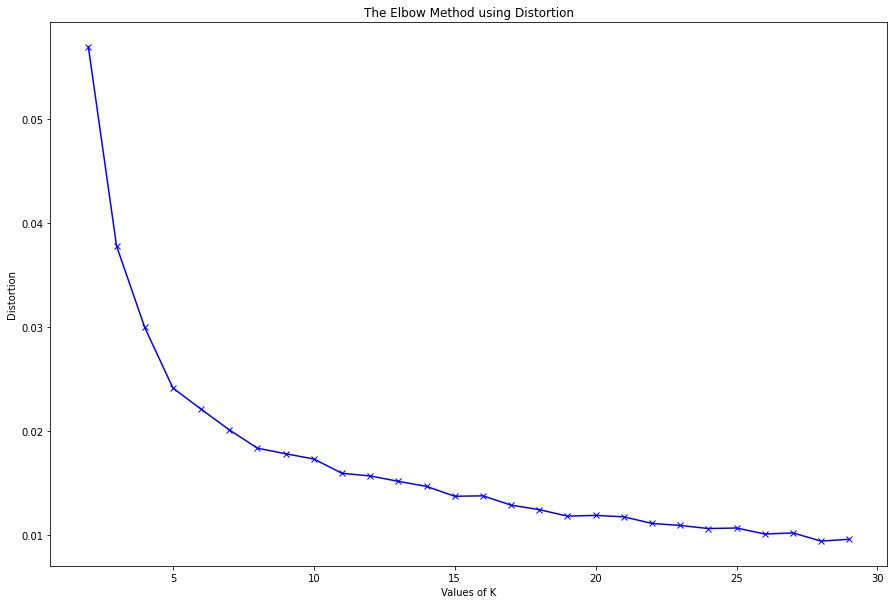

In [55]:
plt.figure(figsize=(15,10))
plt.plot(K, distortions, 'bx-')
plt.xlabel('Values of K')
plt.ylabel('Distortion')
plt.title('The Elbow Method using Distortion')
plt.show()

### Dividing the data into Test/Train

In [56]:
X_train = nyc_events_single.iloc[0:7000,]

X_test = nyc_events_single.iloc[7000: ,]

print(f"Train Set Shape{X_train.shape}")
print(f"Test Set Shape{X_test.shape}")

Train Set Shape(7000, 8)
Test Set Shape(115, 8)


### Applying K-Means for Raw Data

In [57]:
# using the above method I came to conclusion that I will proceed with 3 clusters
kmeans = KMeans(n_clusters=3, init='k-means++')
kmeans.fit(X_train[["longitude","latitude"]])
y = kmeans.labels_
print(f"k = 3, silhouette_score = {silhouette_score(X_train[['longitude','latitude']], y, metric='euclidean')}")

k = 3, silhouette_score = 0.70472450335038


In [58]:
X_train["cluster_labels"] = y
X_train.head()

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,user,longitude,latitude,location_id,longitude_gaussian_values,latitude_gaussian_values,uniform_longitude_values,uniform_latitude_values,cluster_labels
0,0,-73.782806,40.643885,23261,-73.782908,40.646502,-73.781863,40.643532,1
1,5,-73.985056,40.756835,84240,-73.983389,40.760827,-73.985931,40.757042,0
2,8,-73.988105,40.741374,16907,-73.990631,40.742679,-73.988657,40.742151,0
3,15,-73.993435,40.750614,11875,-73.996686,40.752913,-73.993155,40.750432,0
4,16,-73.940631,40.721214,259466,-73.939084,40.719058,-73.941531,40.721295,0


In [59]:
X_train["cluster_labels"].value_counts()

0    5366
1     979
2     655
Name: cluster_labels, dtype: int64

In [60]:
predict = kmeans.predict(X_test[["longitude","latitude"]])

X_test["cluster_labels"] = predict

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until


### Applying KMeans on data transformed using Gaussian Mechanism

In [61]:
# using the above method I came to conclusion that I will proceed with 3 clusters
kmeans_gaussian = KMeans(n_clusters=3, init='k-means++')
kmeans_gaussian.fit(X_train[["longitude_gaussian_values","latitude_gaussian_values"]])
y_gaussian = kmeans_gaussian.labels_
print(f"k = 3, silhouette_score = {silhouette_score(X_train[['longitude_gaussian_values','latitude_gaussian_values']], y_gaussian, metric='euclidean')}")

k = 3, silhouette_score = 0.7027835452203349


In [62]:
gaussian_df_train = pd.DataFrame()
gaussian_df_train["user"] = X_train["user"]
gaussian_df_train["longitude_gaussian_values"] = X_train["longitude_gaussian_values"]
gaussian_df_train["latitude_gaussian_values"] = X_train["latitude_gaussian_values"]
gaussian_df_train["cluster_labels"] = y_gaussian

In [63]:
gaussian_df_train.head()

,user,longitude_gaussian_values,latitude_gaussian_values,cluster_labels
0,0,-73.782908,40.646502,1
1,5,-73.983389,40.760827,2
2,8,-73.990631,40.742679,2
3,15,-73.996686,40.752913,2
4,16,-73.939084,40.719058,2


In [64]:
gaussian_df_train["cluster_labels"].value_counts()

2    5366
1     978
0     656
Name: cluster_labels, dtype: int64

In [65]:
kmeans_gaussian.cluster_centers_

array([[-74.1786466 ,  40.7042508 ],
       [-73.81640639,  40.70239204],
       [-73.9861615 ,  40.74557874]])

In [66]:
predict_gaussian = kmeans_gaussian.predict(X_test[['longitude_gaussian_values','latitude_gaussian_values']])
gaussian_df_test = pd.DataFrame()
gaussian_df_test["user"] = X_test["user"]
gaussian_df_test["longitude_gaussian_values"] = X_test["longitude_gaussian_values"]
gaussian_df_test["latitude_gaussian_values"] = X_test["latitude_gaussian_values"]
gaussian_df_test["cluster_labels"] = predict_gaussian

In [67]:
gaussian_df_test.head()

,user,longitude_gaussian_values,latitude_gaussian_values,cluster_labels
7000,183551,-74.000844,40.723658,2
7001,183594,-73.874599,40.776990,1
7002,183602,-73.991902,40.757113,2
7003,183635,-73.971803,40.754422,2
7004,184038,-73.985994,40.746917,2


### Applying Kmeans on data transformed using Uniform Mechanism

In [68]:
# using the above method I came to conclusion that I will proceed with 15 clusters
kmeans_uniform = KMeans(n_clusters=3, init='k-means++')
kmeans_uniform.fit(X_train[["uniform_longitude_values","uniform_latitude_values"]])
y_uniform = kmeans_uniform.labels_
print(f"k = 3, silhouette_score = {silhouette_score(X_train[['uniform_longitude_values','uniform_latitude_values']], y_uniform, metric='euclidean')}")

k = 3, silhouette_score = 0.7043775049985945


In [69]:
uniform_df_train = pd.DataFrame()
uniform_df_train["user"] = X_train["user"]
uniform_df_train["longitude_uniform_values"] = X_train["uniform_longitude_values"]
uniform_df_train["latitude_uniform_values"] = X_train["uniform_latitude_values"]
uniform_df_train["cluster_labels"] = y_uniform

In [70]:
uniform_df_train.head()

,user,longitude_uniform_values,latitude_uniform_values,cluster_labels
0,0,-73.781863,40.643532,2
1,5,-73.985931,40.757042,0
2,8,-73.988657,40.742151,0
3,15,-73.993155,40.750432,0
4,16,-73.941531,40.721295,0


In [71]:
uniform_df_train["cluster_labels"].value_counts()

0    5366
2     979
1     655
Name: cluster_labels, dtype: int64

In [72]:
predict_uniform = kmeans_uniform.predict(X_test[['uniform_longitude_values','uniform_latitude_values']])
uniform_df_test = pd.DataFrame()
uniform_df_test["user"] = X_test["user"]
uniform_df_test["longitude_uniform_values"] = X_test["uniform_longitude_values"]
uniform_df_test["latitude_uniform_values"] = X_test["uniform_latitude_values"]
uniform_df_test["cluster_labels"] = predict_uniform

In [73]:
uniform_df_test.head()

,user,longitude_uniform_values,latitude_uniform_values,cluster_labels
7000,183551,-74.001427,40.725006,0
7001,183594,-73.872001,40.775426,2
7002,183602,-73.993766,40.756059,0
7003,183635,-73.974356,40.755298,0
7004,184038,-73.986531,40.747624,0


## Comparing Clusters on Map from different Mechanisms

### For Clustering on the data without any Diff Priv Mechanism

In [74]:
cluster_centers_unifrom = folium.Map(location=[40.4774,-74.2589])
cluster_group = folium.FeatureGroup("Clusters")
a = 0
for i in kmeans.cluster_centers_:
    cluster_group.add_child(folium.Marker(location=[i[1],i[0]],popup=f'Center {a}', icon=folium.Icon(color="red", icon="star")))
    a=a+1
cluster_centers_unifrom.add_child(cluster_group)

In [75]:
kmeans_2 = X_train[X_train["cluster_labels"]==2]  

user_id_list = kmeans_2["user"].tolist()
longitude_2_list = kmeans_2["longitude"].tolist()
latitude_2_list = kmeans_2["latitude"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_2_map = folium.Map(location=[kmeans.cluster_centers_[2][1], kmeans.cluster_centers_[2][0]])
folium.Marker(location=[kmeans.cluster_centers_[2][1], kmeans.cluster_centers_[2][0]],popup=f'Cluster_Centre', icon=folium.Icon(color='red',icon='star')).add_to(cluster_2_map)
for user,lat,long in zip(user_id_list,latitude_2_list, longitude_2_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_2_map.add_child(feature_group)

In [76]:
kmeans_0 = X_train[X_train["cluster_labels"]==0]    

user_id_list = kmeans_0["user"].tolist()
longitude_0_list = kmeans_0["longitude"].tolist()
latitude_0_list = kmeans_0["latitude"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_0_map = folium.Map(location=[kmeans.cluster_centers_[0][1], kmeans.cluster_centers_[0][0]])
folium.Marker(location=[kmeans.cluster_centers_[0][1], kmeans.cluster_centers_[0][0]],popup=f'Cluster_Centre', icon=folium.Icon(color='red',icon='star')).add_to(cluster_0_map)
for user,lat,long in zip(user_id_list,latitude_0_list, longitude_0_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_0_map.add_child(feature_group)

### For Uniform Mechanism

In [77]:
cluster_centers_unifrom = folium.Map(location=[40.4774,-74.2589])
cluster_group = folium.FeatureGroup("Clusters")
a = 0
for i in kmeans_uniform.cluster_centers_:
    cluster_group.add_child(folium.Marker(location=[i[1],i[0]],popup=f'Center {a}', icon=folium.Icon(color="red", icon="star")))
    a=a+1
cluster_centers_unifrom.add_child(cluster_group)

In [78]:
uniform_0 = uniform_df_train[uniform_df_train["cluster_labels"]==0]  

user_id_list = uniform_0["user"].tolist()
longitude_0_list = uniform_0["longitude_uniform_values"].tolist()
latitude_0_list = uniform_0["latitude_uniform_values"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_0_map = folium.Map(location=[kmeans_uniform.cluster_centers_[0][1], kmeans_uniform.cluster_centers_[0][0]])
folium.Marker(location=[kmeans_uniform.cluster_centers_[0][1], kmeans_uniform.cluster_centers_[0][0]],popup=f'Cluster_Centre', icon=folium.Icon(color='red',icon='star')).add_to(cluster_0_map)
for user,lat,long in zip(user_id_list,latitude_0_list, longitude_0_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_0_map.add_child(feature_group)

In [79]:
uniform_1 = uniform_df_train[uniform_df_train["cluster_labels"]==2]  

user_id_list = uniform_1["user"].tolist()
longitude_1_list = uniform_1["longitude_uniform_values"].tolist()
latitude_1_list = uniform_1["latitude_uniform_values"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_2_map = folium.Map(location=[kmeans_uniform.cluster_centers_[2][1], kmeans_uniform.cluster_centers_[2][0]])
folium.Marker(location=[kmeans_uniform.cluster_centers_[2][1], kmeans_uniform.cluster_centers_[2][0]],popup=f'Cluster_Centre', icon=folium.Icon(color='red',icon='star')).add_to(cluster_2_map)
for user,lat,long in zip(user_id_list,latitude_1_list, longitude_1_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_2_map.add_child(feature_group)

### For Gaussian Mechanism

In [80]:
cluster_centers_gaussian = folium.Map(location=[40.4774,-74.2589])
cluster_group_gaussian = folium.FeatureGroup("Clusters")
a = 0
for i in kmeans_gaussian.cluster_centers_:
    cluster_group_gaussian.add_child(folium.Marker(location=[i[1],i[0]],popup=f'Center {a}', icon=folium.Icon(color="red", icon="star")))
    a=a+1
cluster_centers_gaussian.add_child(cluster_group_gaussian)

In [81]:
gaussian_1 = gaussian_df_train[gaussian_df_train["cluster_labels"]==1]

user_id_list = gaussian_1["user"].tolist()
longitude_1_list = gaussian_1["longitude_gaussian_values"].tolist()
latitude_1_list = gaussian_1["latitude_gaussian_values"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_1_map = folium.Map(location=[kmeans_gaussian.cluster_centers_[1][1], kmeans_gaussian.cluster_centers_[1][0]])
folium.Marker(location=[kmeans_gaussian.cluster_centers_[1][1], kmeans_gaussian.cluster_centers_[1][0]],popup=f'Cluster_Centre', icon=folium.Icon(color='red',icon='star')).add_to(cluster_1_map)
for user,lat,long in zip(user_id_list,latitude_1_list, longitude_1_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_1_map.add_child(feature_group)

In [82]:
gaussian_2 = gaussian_df_train[gaussian_df_train["cluster_labels"]==2]

user_id_list = gaussian_1["user"].tolist()
longitude_2_list = gaussian_2["longitude_gaussian_values"].tolist()
latitude_2_list = gaussian_2["latitude_gaussian_values"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_2_map = folium.Map(location=[kmeans_gaussian.cluster_centers_[2][1], kmeans_gaussian.cluster_centers_[2][0]])
folium.Marker(location=[kmeans_gaussian.cluster_centers_[2][1], kmeans_gaussian.cluster_centers_[2][0]],popup=f'Cluster_Centre 0', icon=folium.Icon(color='red',icon='star')).add_to(cluster_2_map)
for user,lat,long in zip(user_id_list,latitude_2_list, longitude_2_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_2_map.add_child(feature_group)

## Calculating Distance between the points in KM

### Distance for Gaussian Mechanism

In [83]:
actual_location = list(zip(X_train["latitude"].tolist(), X_train["longitude"].tolist()))

In [84]:
gaussian_location = list(zip(gaussian_df_train["latitude_gaussian_values"].tolist(),gaussian_df_train["longitude_gaussian_values"].tolist()))

In [85]:
distance_gaussian = []
for f,b in zip(actual_location, gaussian_location):
    distance_gaussian.append(hs.haversine(f,b, unit=hs.Unit.METERS))

In [86]:
gaussian_df_train["location_difference"] = distance_gaussian

In [87]:
gaussian_df_train["location_difference"].mean()

248.6391871637428

In [88]:
gaussian_df_train

,user,longitude_gaussian_values,latitude_gaussian_values,cluster_labels,location_difference
0,0,-73.782908,40.646502,1,291.171866
1,5,-73.983389,40.760827,2,465.590006
2,8,-73.990631,40.742679,2,257.558486
3,15,-73.996686,40.752913,2,374.674987
4,16,-73.939084,40.719058,2,272.854343
...,...,...,...,...,...
6995,182676,-73.974691,40.762406,2,219.312985
6996,182684,-73.972353,40.760354,2,392.998684
6997,182808,-73.988321,40.747549,2,193.495624
6998,183263,-73.979014,40.735281,2,509.748752


### Distance for Uniform Mechanism

In [89]:
uniform_location = list(zip(uniform_df_train["latitude_uniform_values"].tolist(),uniform_df_train["longitude_uniform_values"].tolist()))

In [90]:
distance_uniform = []
for f,b in zip(actual_location, uniform_location):
    distance_uniform.append(hs.haversine(f,b, unit=hs.Unit.METERS))

In [91]:
uniform_df_train["location_difference"] = distance_uniform

In [92]:
uniform_df_train

,user,longitude_uniform_values,latitude_uniform_values,cluster_labels,location_difference
0,0,-73.781863,40.643532,2,88.694505
1,5,-73.985931,40.757042,0,77.222070
2,8,-73.988657,40.742151,0,98.057284
3,15,-73.993155,40.750432,0,31.050060
4,16,-73.941531,40.721295,0,76.427917
...,...,...,...,...,...
6995,182676,-73.972752,40.764468,0,69.232992
6996,182684,-73.972740,40.763231,0,71.891152
6997,182808,-73.988701,40.745588,0,47.381924
6998,183263,-73.983003,40.738189,0,59.863709


In [93]:
uniform_df_train["location_difference"].mean()

75.53173526295728

## Applying K-Anonymity on the data

In [94]:
k_anonymized_latitude = []
k_anonymized_longitude = []
for (lat, long) in actual_location:
    k_anonymized_latitude.append(random.uniform(lat, lat+0.005))
    k_anonymized_longitude.append(random.uniform(long, long-0.005))

In [95]:
X_train["latitude_k_anonymized"] = k_anonymized_latitude
X_train["longitude_k_anonymized"] = k_anonymized_longitude

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


### Applying K-Means Clustering on k-Anonymized Data

In [96]:
kmeans_k = KMeans(n_clusters=3,init="k-means++")
kmeans_k.fit(X_train[["latitude_k_anonymized","longitude_k_anonymized"]])
y_k = kmeans_k.labels_
print(f"k = 3, silhouette_score = {silhouette_score(X_train[['latitude_k_anonymized','longitude_k_anonymized']], y_k, metric='euclidean')}")

k = 3, silhouette_score = 0.7033832166270212


In [97]:
kmeans_k_df = X_train[["user","latitude_k_anonymized", "longitude_k_anonymized"]]
kmeans_k_df["cluster_labels"] = y_k

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


In [98]:
kmeans_k_df["cluster_labels"].value_counts()

0    5366
1     979
2     655
Name: cluster_labels, dtype: int64

In [99]:
kmeans_k_map= folium.Map(location=[kmeans_k_df["latitude_k_anonymized"][0], kmeans_k_df["longitude_k_anonymized"][0]])
folium.Marker(
    location=[kmeans_k_df["latitude_k_anonymized"][0], kmeans_k_df["longitude_k_anonymized"][0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Location with Gaussian', # pop-up label for the marker
    icon=folium.Icon()
).add_to(kmeans_k_map)
folium.Marker(
    location=[nyc_events_single["latitude"][0], nyc_events_single["longitude"][0]], # coordinates for the marker (Earth Lab at CU Boulder)
    popup='User 1 Actual Location', # pop-up label for the marker
    icon=folium.Icon(color="red")
).add_to(kmeans_k_map)

In [100]:
kmeans_k_map

In [101]:
cluster_centers_k = folium.Map(location=[40.4774,-74.2589])
cluster_group_k = folium.FeatureGroup("Clusters")
a = 0
for i in kmeans_k.cluster_centers_:
    cluster_group_k.add_child(folium.Marker(location=[i[1],i[0]],popup=f'Center {a}', icon=folium.Icon(color="red", icon="star")))
    a=a+1
cluster_centers_k.add_child(cluster_group_gaussian)

In [102]:
kmeans_k_2 = kmeans_k_df[kmeans_k_df["cluster_labels"]==2]

user_id_list = kmeans_k_2["user"].tolist()
longitude_2_list = kmeans_k_2["longitude_k_anonymized"].tolist()
latitude_2_list = kmeans_k_2["latitude_k_anonymized"].tolist()
feature_group = folium.FeatureGroup("Locations")
cluster_2_map = folium.Map(location=[40.70418279, -74.18088997])
folium.Marker(location=[40.70418279, -74.18088997],popup=f'Cluster_Centre 0', icon=folium.Icon(color='red',icon='star')).add_to(cluster_2_map)
for user,lat,long in zip(user_id_list,latitude_2_list, longitude_2_list):
    feature_group.add_child(folium.Marker(location=[lat,long],popup=f'User {user} Location with Uniform', icon=folium.Icon(color="green", icon="flag")))
cluster_2_map.add_child(feature_group)

#### As the Cluster Centers are similar to other mechanisms and raw model, we will focus on the distance variation from the given location to the anonymized location

In [103]:
anonymized_location = list(zip(k_anonymized_latitude, k_anonymized_longitude))

In [104]:
distance_k = []
for f,b in zip(actual_location, anonymized_location):
    distance_k.append(hs.haversine(f,b, unit=hs.Unit.METERS))

In [105]:
kmeans_k_df["location_difference"] = distance_k

C:\Users\shubh\.conda\envs\tensorflow-python3.6\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


In [106]:
kmeans_k_df

,user,latitude_k_anonymized,longitude_k_anonymized,cluster_labels,location_difference
0,0,40.648417,-73.786101,1,575.519403
1,5,40.758371,-73.988221,0,316.627801
2,8,40.742030,-73.991949,0,331.920580
3,15,40.752923,-73.994444,0,270.421110
4,16,40.722244,-73.943431,0,262.297353
...,...,...,...,...,...
6995,182676,40.764367,-73.976027,0,266.632082
6996,182684,40.768725,-73.974283,0,552.737388
6997,182808,40.749009,-73.989761,0,378.634253
6998,183263,40.740480,-73.984475,0,230.925363


In [107]:
kmeans_k_df["location_difference"].mean()

375.15483309389873